# P424-Hotel Rating Classification
## The major objective is what are the attributes that travelers are considering while selecting a hotel. 
## With this manager can understand which elements of their hotel influence more in forming a positive review or improves hotel brand image.

## STEP 1 DATA COLLECTION

In [1]:
#from google.colab import files
#uploaded = files.upload()

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

df = pd.read_excel("Hotel_Reviews.xlsx")
df

,Review,Feedback
0,nice hotel expensive parking got good deal sta...,Pos
1,ok nothing special charge diamond member hilto...,Neg
2,nice rooms not 4* experience hotel monaco seat...,Pos
3,"unique, great stay, wonderful time hotel monac...",Pos
4,"great stay great stay, went seahawk game aweso...",Pos
...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",Pos
20487,great location price view hotel great quick pl...,Pos
20488,"ok just looks nice modern outside, desk staff ...",Neg
20489,hotel theft ruined vacation hotel opened sept ...,Neg


## STEP 2 EXPLORATORY DATA ANALYSIS

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20491 entries, 0 to 20490
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Review    20491 non-null  object
 1   Feedback  20491 non-null  object
dtypes: object(2)
memory usage: 320.3+ KB


In [4]:
((df.isnull().sum()/len(df)*100))

Review      0.0
Feedback    0.0
dtype: float64

In [5]:
#Counting null values
df.isnull().sum().sort_values(ascending=True)

Review      0
Feedback    0
dtype: int64

In [6]:
df["Feedback"].value_counts()

Feedback
Pos    17277
Neg     3214
Name: count, dtype: int64

Text(0.5, 1.0, 'Distribution of Rating')

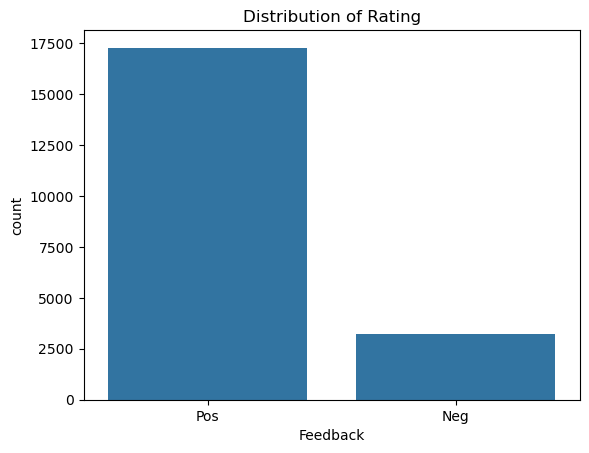

In [7]:
sns.countplot(x='Feedback',data= df)
plt.title("Distribution of Rating")

### we see mostly mostly positive reviews

In [8]:
print(df["Feedback"].value_counts()/len(df))

Feedback
Pos    0.843151
Neg    0.156849
Name: count, dtype: float64


##  84 percent reviews are positive and 15 percent reviews are negative

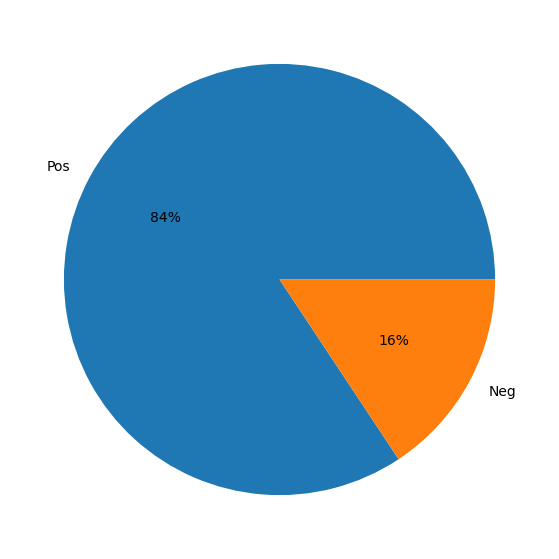

In [9]:
#plotting pie chart
plt.figure(figsize=(15,7))
plt.pie(df['Feedback'].value_counts(), labels = ['Pos','Neg',], autopct='%.0f%%');

In [10]:
#creating a new column for length of the data
df['len']=df['Review'].apply(len)
df

,Review,Feedback,len
0,nice hotel expensive parking got good deal sta...,Pos,593
1,ok nothing special charge diamond member hilto...,Neg,1689
2,nice rooms not 4* experience hotel monaco seat...,Pos,1427
3,"unique, great stay, wonderful time hotel monac...",Pos,600
4,"great stay great stay, went seahawk game aweso...",Pos,1281
...,...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",Pos,733
20487,great location price view hotel great quick pl...,Pos,306
20488,"ok just looks nice modern outside, desk staff ...",Neg,443
20489,hotel theft ruined vacation hotel opened sept ...,Neg,5557


In [11]:
df['len'].max() # 13501 letters are in the largest review

13501

In [12]:
df['len'].min() # 44 letters are in smallest review

44

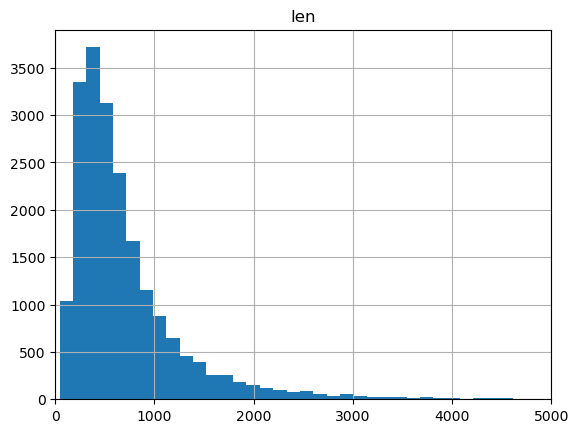

In [13]:
# histogram showing the overall distribution of Review post lengths.

import matplotlib.pyplot as plt
df.hist(bins=100)
plt.xlim(0, 5000)
plt.show()

## the review word length does not show a normal distribution

In [14]:
#label encoding the feedback column and creating new column feedback2 
from sklearn.preprocessing import LabelEncoder
LE = LabelEncoder()
df["Feedback2"] = LE.fit_transform(df["Feedback"])
df

,Review,Feedback,len,Feedback2
0,nice hotel expensive parking got good deal sta...,Pos,593,1
1,ok nothing special charge diamond member hilto...,Neg,1689,0
2,nice rooms not 4* experience hotel monaco seat...,Pos,1427,1
3,"unique, great stay, wonderful time hotel monac...",Pos,600,1
4,"great stay great stay, went seahawk game aweso...",Pos,1281,1
...,...,...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",Pos,733,1
20487,great location price view hotel great quick pl...,Pos,306,1
20488,"ok just looks nice modern outside, desk staff ...",Neg,443,0
20489,hotel theft ruined vacation hotel opened sept ...,Neg,5557,0


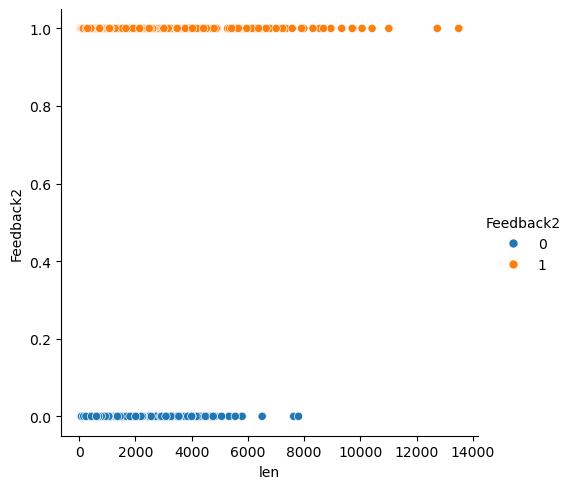

In [15]:
# plotting negative vs positive reviews
sns.relplot(data=df, x="len", y="Feedback2", hue="Feedback2")

## STEP 3 DATA CLEANING | PREPROCESSING

In [16]:
# !pip install spacy

In [17]:
import nltk
import re
import spacy
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\dekrk\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\dekrk\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

## Tokenization(lowercase-->remove punct-->remove stopwords)

In [18]:
# Define a function to preprocess text
def preprocess_text(text):
    # Convert text to lowercase
    text = text.lower()
    # Remove punctuation
    text = re.sub(r'[^\w\s]', '', text)
    # Tokenization
    tokens = nltk.word_tokenize(text)
    # Remove stopwords
    stopwords_list = set(stopwords.words('english'))
    tokens = [word for word in tokens if word not in stopwords_list]
    # Join tokens back into text
    text = ' '.join(tokens)
    return text

In [19]:
#Apply text preprocessing to the 'Review' column and creating new cloumn with preprocessed text
df['cleaned_review']=df['Review'].apply(preprocess_text)
df

,Review,Feedback,len,Feedback2,cleaned_review
0,nice hotel expensive parking got good deal sta...,Pos,593,1,nice hotel expensive parking got good deal sta...
1,ok nothing special charge diamond member hilto...,Neg,1689,0,ok nothing special charge diamond member hilto...
2,nice rooms not 4* experience hotel monaco seat...,Pos,1427,1,nice rooms 4 experience hotel monaco seattle g...
3,"unique, great stay, wonderful time hotel monac...",Pos,600,1,unique great stay wonderful time hotel monaco ...
4,"great stay great stay, went seahawk game aweso...",Pos,1281,1,great stay great stay went seahawk game awesom...
...,...,...,...,...,...
20486,"best kept secret 3rd time staying charm, not 5...",Pos,733,1,best kept secret 3rd time staying charm 5star ...
20487,great location price view hotel great quick pl...,Pos,306,1,great location price view hotel great quick pl...
20488,"ok just looks nice modern outside, desk staff ...",Neg,443,0,ok looks nice modern outside desk staff nt par...
20489,hotel theft ruined vacation hotel opened sept ...,Neg,5557,0,hotel theft ruined vacation hotel opened sept ...


In [20]:
#creating a list of all the words from the cleaned review column
reviews = df.cleaned_review.values
review_text = ' '.join(reviews)

In [21]:
#again tokenising the list of words
from nltk.tokenize import word_tokenize
new_tokens=word_tokenize(review_text)

## Stemming

In [22]:
#importing nltk porter stemmer
from nltk.stem import PorterStemmer
ps=PorterStemmer()
stemmed_tokens=[ps.stem(word) for word in new_tokens]
print(stemmed_tokens[100:200])

['descript', 'suit', 'bedroom', 'bathroom', 'standard', 'hotel', 'room', 'took', 'print', 'reserv', 'desk', 'show', 'said', 'thing', 'like', 'tv', 'couch', 'ect', 'desk', 'clerk', 'told', 'oh', 'mix', 'suit', 'descript', 'kimpton', 'websit', 'sorri', 'free', 'breakfast', 'got', 'kid', 'embassi', 'suit', 'sit', 'room', 'bathroom', 'bedroom', 'unlik', 'kimpton', 'call', 'suit', '5', 'day', 'stay', 'offer', 'correct', 'fals', 'advertis', 'send', 'kimpton', 'prefer', 'guest', 'websit', 'email', 'ask', 'failur', 'provid', 'suit', 'advertis', 'websit', 'reserv', 'descript', 'furnish', 'hard', 'copi', 'reserv', 'printout', 'websit', 'desk', 'manag', 'duti', 'repli', 'solut', 'send', 'email', 'trip', 'guest', 'survey', 'follow', 'email', 'mail', 'guess', 'tell', 'concern', 'guestth', 'staff', 'rang', 'indiffer', 'help', 'ask', 'desk', 'good', 'breakfast', 'spot', 'neighborhood', 'hood', 'told', 'hotel', 'gee']


In [23]:
len(stemmed_tokens)

2063025

In [24]:
doc1=[]
for i in range (0, len(stemmed_tokens) , 10000):
    if(i<len(stemmed_tokens)):
        doc1.append(stemmed_tokens[0:10000])
    else : doc1.append(stemmed_tokens[-i:])

In [25]:
# use spacy to process and analyse the stemmed text
import spacy

# Load the model
nlp = spacy.load("en_core_web_sm")

# Check if the model is loaded successfully
print(nlp)


In [26]:
#creating a function nlp with a pretrained spacey model 
nlp=spacy.load('en_core_web_sm')
for word_list in doc1:
    doc=nlp(' '.join(word_list))
print(doc)

nice hotel expens park got good deal stay hotel anniversari arriv late even took advic previou review valet park check quick easi littl disappoint nonexist view room room clean nice size bed comfort woke stiff neck high pillow soundproof like heard music room night morn loud bang door open close hear peopl talk hallway mayb noisi neighbor aveda bath product nice goldfish stay nice touch taken advantag stay longer locat great walk distanc shop overal nice experi pay 40 park night ok noth special charg diamond member hilton decid chain shot 20th anniversari seattl start book suit paid extra websit descript suit bedroom bathroom standard hotel room took print reserv desk show said thing like tv couch ect desk clerk told oh mix suit descript kimpton websit sorri free breakfast got kid embassi suit sit room bathroom bedroom unlik kimpton call suit 5 day stay offer correct fals advertis send kimpton prefer guest websit email ask failur provid suit advertis websit reserv descript furnish hard

In [27]:
len(doc)

10038

# Lemmatization

In [28]:
lemmas=[token.lemma_ for token in doc]
lemmas

['nice',
 'hotel',
 'expen',
 'park',
 'get',
 'good',
 'deal',
 'stay',
 'hotel',
 'anniversari',
 'arriv',
 'late',
 'even',
 'take',
 'advic',
 'previou',
 'review',
 'valet',
 'park',
 'check',
 'quick',
 'easi',
 'littl',
 'disappoint',
 'nonexist',
 'view',
 'room',
 'room',
 'clean',
 'nice',
 'size',
 'bed',
 'comfort',
 'wake',
 'stiff',
 'neck',
 'high',
 'pillow',
 'soundproof',
 'like',
 'hear',
 'music',
 'room',
 'night',
 'morn',
 'loud',
 'bang',
 'door',
 'open',
 'close',
 'hear',
 'peopl',
 'talk',
 'hallway',
 'mayb',
 'noisi',
 'neighbor',
 'aveda',
 'bath',
 'product',
 'nice',
 'goldfish',
 'stay',
 'nice',
 'touch',
 'take',
 'advantag',
 'stay',
 'long',
 'locat',
 'great',
 'walk',
 'distanc',
 'shop',
 'overal',
 'nice',
 'experi',
 'pay',
 '40',
 'park',
 'night',
 'ok',
 'noth',
 'special',
 'charg',
 'diamond',
 'member',
 'hilton',
 'decid',
 'chain',
 'shoot',
 '20th',
 'anniversari',
 'seattl',
 'start',
 'book',
 'suit',
 'pay',
 'extra',
 'websit',
 '

In [29]:
lem_reviews=' '.join(lemmas)
lem_reviews

'nice hotel expen park get good deal stay hotel anniversari arriv late even take advic previou review valet park check quick easi littl disappoint nonexist view room room clean nice size bed comfort wake stiff neck high pillow soundproof like hear music room night morn loud bang door open close hear peopl talk hallway mayb noisi neighbor aveda bath product nice goldfish stay nice touch take advantag stay long locat great walk distanc shop overal nice experi pay 40 park night ok noth special charg diamond member hilton decid chain shoot 20th anniversari seattl start book suit pay extra websit descript suit bedroom bathroom standard hotel room take print reserv desk show say thing like tv couch ect desk clerk tell oh mix suit descript kimpton websit sorri free breakfast get kid embassi suit sit room bathroom bedroom unlik kimpton call suit 5 day stay offer correct fal advertis send kimpton prefer guest websit email ask failur provid suit advertis websit reserv descript furnish hard copi 

# Feature extraction

## Count vectorization

In [30]:
#Count vectorization to find the frequency of each word
from sklearn.feature_extraction.text import CountVectorizer
cv=CountVectorizer()
Reviews_cv=cv.fit_transform(lemmas)

In [31]:
print(cv.vocabulary_)

{'nice': 1348, 'hotel': 1024, 'expen': 753, 'park': 1445, 'get': 900, 'good': 918, 'deal': 581, 'stay': 1918, 'anniversari': 178, 'arriv': 213, 'late': 1145, 'even': 734, 'take': 1979, 'advic': 137, 'previou': 1540, 'review': 1672, 'valet': 2133, 'check': 421, 'quick': 1586, 'easi': 683, 'littl': 1176, 'disappoint': 621, 'nonexist': 1360, 'view': 2146, 'room': 1693, 'clean': 446, 'size': 1824, 'bed': 290, 'comfort': 473, 'wake': 2157, 'stiff': 1925, 'neck': 1331, 'high': 994, 'pillow': 1486, 'soundproof': 1866, 'like': 1169, 'hear': 980, 'music': 1321, 'night': 1350, 'morn': 1309, 'loud': 1195, 'bang': 268, 'door': 641, 'open': 1399, 'close': 455, 'peopl': 1467, 'talk': 1980, 'hallway': 959, 'mayb': 1251, 'noisi': 1355, 'neighbor': 1340, 'aveda': 243, 'bath': 280, 'product': 1556, 'goldfish': 917, 'touch': 2041, 'advantag': 134, 'long': 1190, 'locat': 1184, 'great': 932, 'walk': 2159, 'distanc': 631, 'shop': 1795, 'overal': 1421, 'experi': 755, 'pay': 1461, '40': 69, 'ok': 1389, 'noth'

In [32]:
#getting some random feature names from index 100 to 199
print(cv.get_feature_names_out()[100:200])

['905' '930' 'aaa' 'aadvantag' 'abl' 'absolut' 'ac' 'accept' 'access'
 'accessori' 'accommod' 'accomod' 'accross' 'accur' 'ace' 'aceit' 'acheat'
 'acknowledg' 'acoust' 'acquir' 'activ' 'actual' 'acual' 'ad' 'add'
 'addit' 'address' 'adequ' 'adjac' 'adjust' 'admit' 'ador' 'adorn'
 'advanc' 'advantag' 'adventur' 'advertis' 'advic' 'advis' 'advisor'
 'affect' 'afford' 'afternoon' 'age' 'agenc' 'aggrav' 'ago' 'agre' 'aid'
 'air' 'airconditionera' 'airport' 'al' 'albeit' 'alcohol' 'alley' 'alot'
 'am' 'aman' 'amaz' 'amazingli' 'ambul' 'amen' 'ami' 'amman' 'ammen'
 'amreport' 'amtrak' 'amus' 'amusingthi' 'anacort' 'andor' 'andpress'
 'andra' 'andstat' 'anim' 'ann' 'annei' 'anniversari' 'annoy' 'annoyingon'
 'answer' 'anticip' 'antiqu' 'anxious' 'anybodi' 'anythingit' 'anywho'
 'apart' 'apathi' 'apolog' 'apologet' 'appal' 'appar' 'apparantli'
 'appeal' 'appear' 'appet' 'appl' 'appoint']


## wordcloud for all words used in reviews

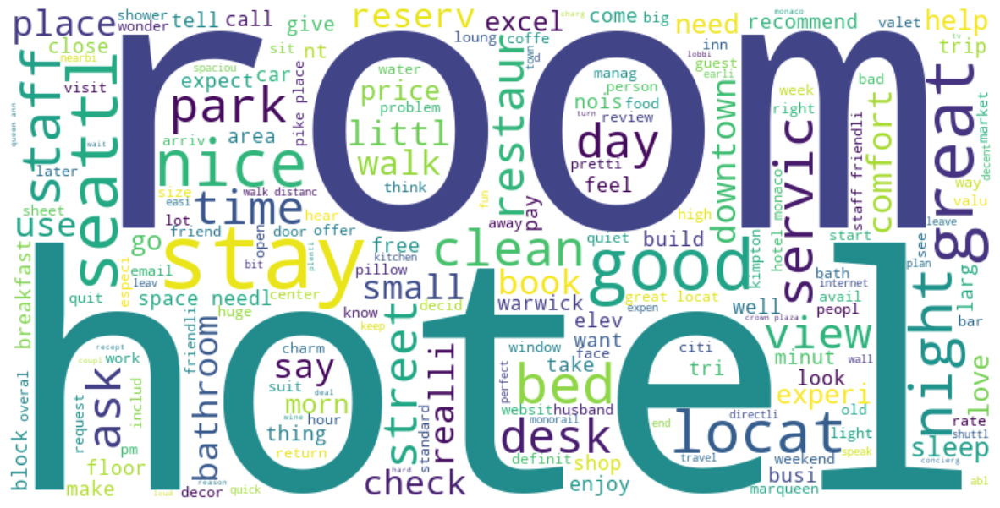

In [33]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import numpy as np

# Generate a word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(lem_reviews)
wordcloud
plt.figure(figsize=(15, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  # Hide axes
plt.show()

# Top 200 Most Frequest Words

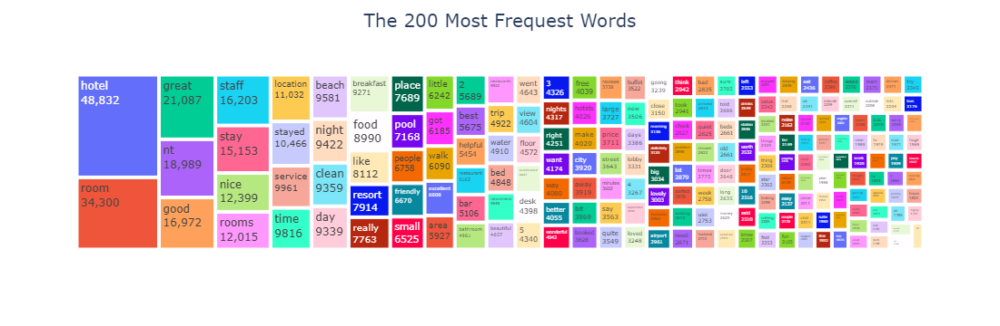

In [34]:
import plotly.express as px
mostUsedWords = df['cleaned_review'].str.split(expand=True).stack().value_counts()
mostUsedWords_top200 = mostUsedWords[:200]

# Use 'MostUsedWords_top200' as the values for the treemap
fig = px.treemap(mostUsedWords_top200,
                 path=[mostUsedWords_top200.index],
                 values=mostUsedWords_top200)  # Pass the Series itself as values

fig.update_layout(title_text='The 200 Most Frequest Words',
                  title_x=0.5, title_font=dict(size=20)
                  )
fig.update_traces(textinfo="label+value")
fig.show()

# Wordcloud for Positive Reviews

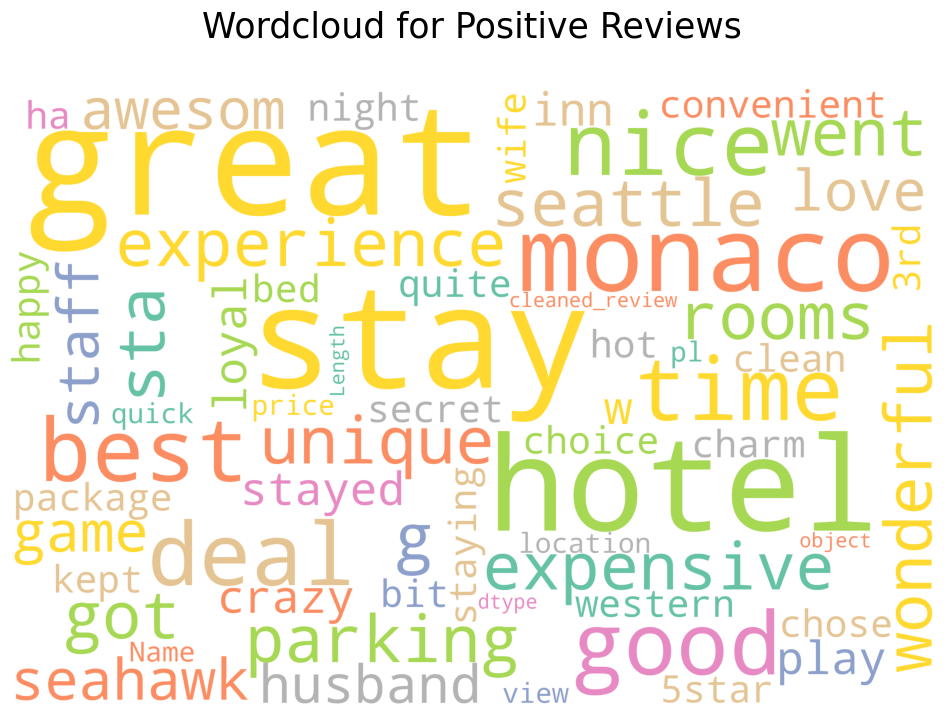

In [35]:
wordcloud = WordCloud(width=3000,
                      height=2000,
                      background_color='White',
                      colormap='Set2',
#                       stopwords=stop_words_,
#                       max_words=100,
                      random_state=42,
                      max_font_size = 500
                      ).generate(str(df[df['Feedback2'] == 1]['cleaned_review']))

plt.figure(figsize=(15,8))
plt.imshow(wordcloud)
plt.axis('off')
plt.title("Wordcloud for Positive Reviews", y=1.07, fontsize=25)
plt.show()

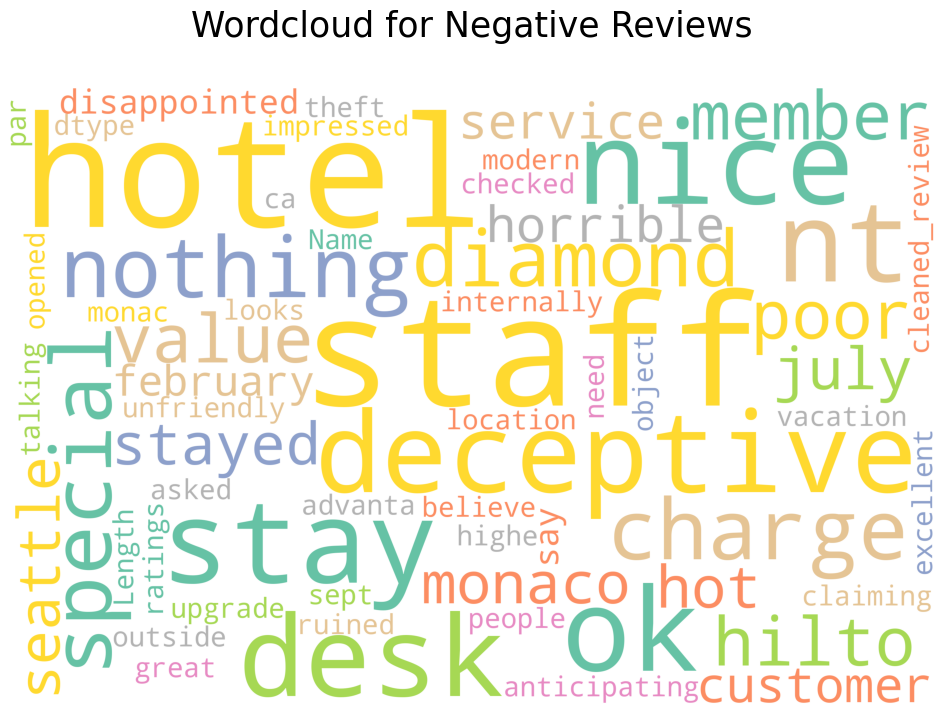

In [36]:
wordcloud = WordCloud(width=3000,
                      height=2000,
                      background_color='White',
                      colormap='Set2',
#                       stopwords=stop_words_,
#                       max_words=100,
                      random_state=42,
                      max_font_size = 500
                      ).generate(str(df[df['Feedback2'] == 0]['cleaned_review']))

plt.figure(figsize=(15,8))
plt.imshow(wordcloud)
plt.axis('off')
plt.title("Wordcloud for Negative Reviews", y=1.07, fontsize=25)
plt.show()

## TFIDF (Term Frequency with Count Vetorizer)

In [37]:
# Stop word
stop_words_keywords = stopwords.words('english')

# special additioanl stop words added for keyword extraction
stop_words_keywords.extend(["will", "always", "go", "one", "very", "good", "only", "mr", "lot", "two",
                            "th", "etc", "don", "due", "didn", "since", "nt", "ms", "ok", "almost",
                            "put", "pm", "hyatt", "grand", "till", "add", "let", "hotel", "able",
                            "per", "st", "couldn", "yet", "par", "hi", "well", "would", "I", "the",
                            "s", "also", "great", "get", "like", "take", "thank"
                            ])

In [38]:
# find the most frequent words in the data, extracting information about its content and topics.
corpus = df['cleaned_review']
stops = set(stopwords.words('english') + ['com'])
co = CountVectorizer(stop_words=stop_words_keywords)
counts = co.fit_transform(corpus)
most_freq_terms = pd.DataFrame(counts.sum(axis=0),columns=co.get_feature_names_out()).T.sort_values(0, ascending=False).head(25)

<Axes: title={'center': 'Unigram Frequency'}>

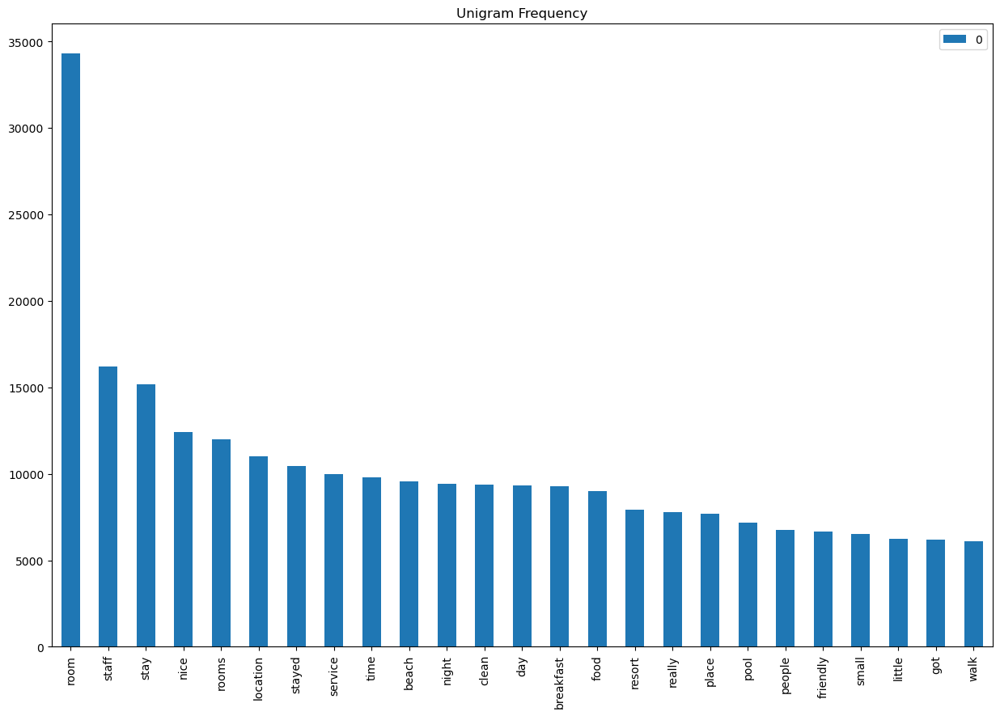

In [39]:
most_freq_terms.plot(kind='bar', title='Unigram Frequency', figsize=(15, 10))

Bi grams

In [40]:
# Now we can check for frequent bi-grams:
co = CountVectorizer(ngram_range=(2, 2), stop_words=stop_words_keywords)
counts1 = co.fit_transform(corpus)
bi_grams = pd.DataFrame(counts1.sum(axis=0),columns=co.get_feature_names_out()).T.sort_values(0, ascending=False).head(25)

<Axes: title={'center': 'bi-grams'}>

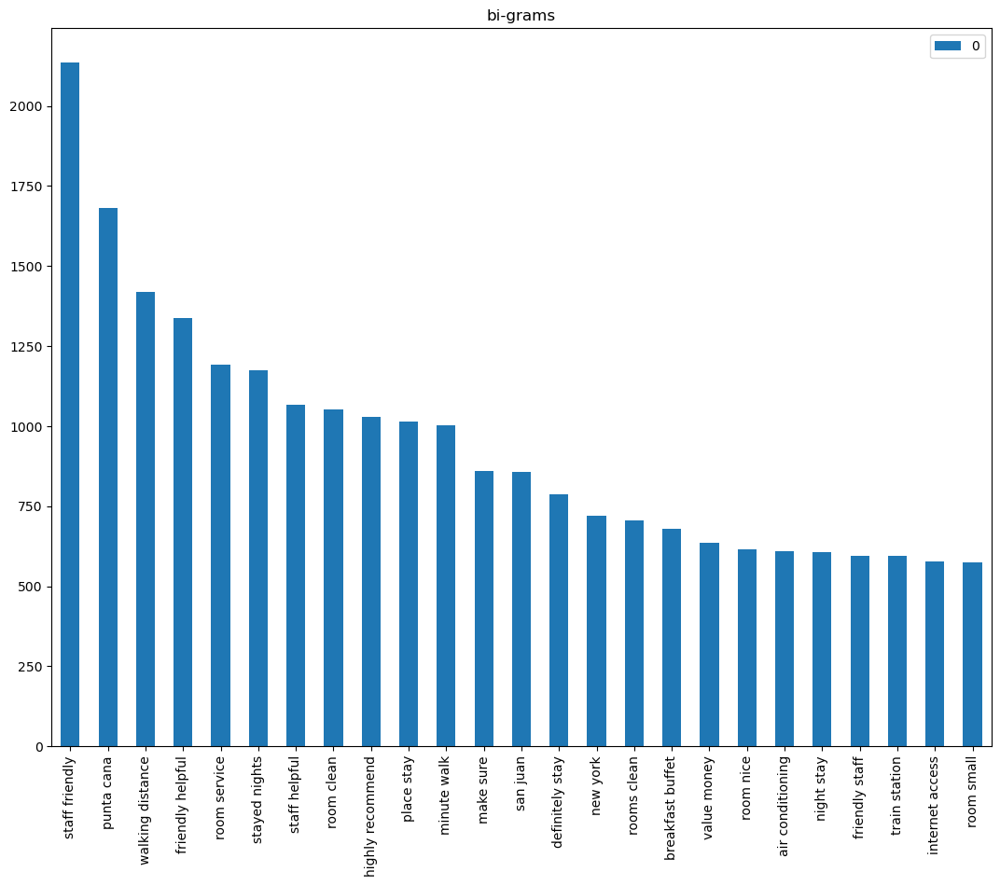

In [41]:
bi_grams.plot(kind='bar', title='bi-grams', figsize=(13, 10))

tri grams


In [42]:
# Now we can check for frequent tri-grams:
co = CountVectorizer(ngram_range=(3, 3), stop_words=stop_words_keywords)
counts1 = co.fit_transform(corpus)
tri_grams = pd.DataFrame(counts1.sum(axis=0),columns=co.get_feature_names_out()).T.sort_values(0, ascending=False).head(25)

<Axes: title={'center': 'tri-grams'}>

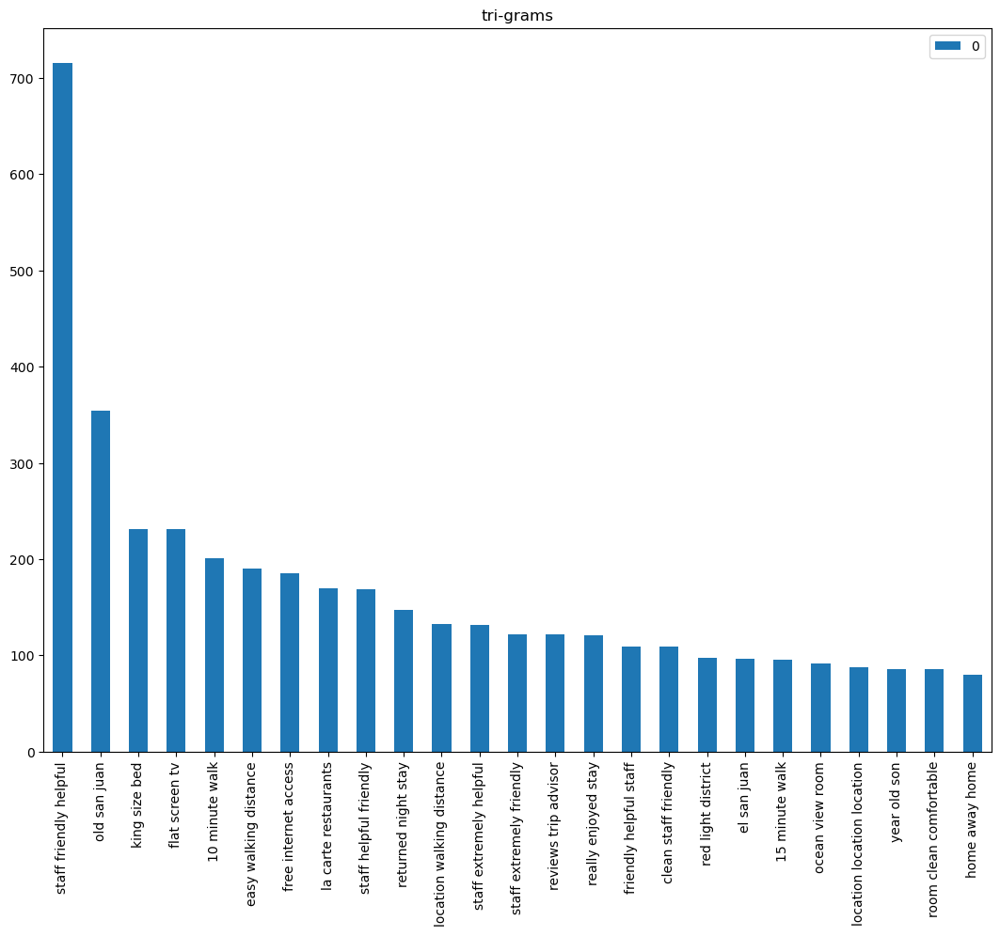

In [43]:
tri_grams.plot(kind='bar', title='tri-grams', figsize=(13, 10))

# Named Entity Recognition (NER)
## identifying and classifying named entities in text into predefined categories such as names of people, organizations, locations, dates, and other specific entities

In [44]:
nlp=spacy.load('en_core_web_sm')

one_block=lem_reviews
doc_block=nlp(one_block)
spacy.displacy.render(doc_block,style='ent',jupyter=True)

In [45]:
for token in doc_block[100:200]:
    print(token,token.pos_)

descript PROPN
suit NOUN
bedroom NOUN
bathroom NOUN
standard ADJ
hotel NOUN
room NOUN
take VERB
print NOUN
reserv PROPN
desk NOUN
show PROPN
say VERB
thing NOUN
like ADP
tv NOUN
couch NOUN
ect NOUN
desk NOUN
clerk NOUN
tell VERB
oh INTJ
mix NOUN
suit NOUN
descript PROPN
kimpton PROPN
websit PROPN
sorri PROPN
free ADJ
breakfast NOUN
get VERB
kid ADJ
embassi ADJ
suit NOUN
sit VERB
room NOUN
bathroom NOUN
bedroom NOUN
unlik PROPN
kimpton PROPN
call VERB
suit NOUN
5 NUM
day NOUN
stay NOUN
offer NOUN
correct ADJ
fal NOUN
advertis NOUN
send VERB
kimpton PROPN
prefer VERB
guest NOUN
websit NOUN
email NOUN
ask VERB
failur PROPN
provid PROPN
suit PROPN
advertis PROPN
websit NOUN
reserv PROPN
descript PROPN
furnish PROPN
hard PROPN
copi PROPN
reserv PROPN
printout PROPN
websit PROPN
desk PROPN
manag PROPN
duti PROPN
repli PROPN
solut NOUN
send VERB
email NOUN
trip NOUN
guest NOUN
survey NOUN
follow NOUN
email NOUN
mail NOUN
guess NOUN
tell VERB
concern NOUN
guestth ADJ
staff NOUN
rang PROPN
indi

In [46]:
nouns_verbs=[token.text for token in doc_block if token.pos_ in ('NOUN','VERB')]
print(nouns_verbs[100:200])

['guest', 'survey', 'follow', 'email', 'mail', 'guess', 'tell', 'concern', 'staff', 'help', 'ask', 'desk', 'breakfast', 'spot', 'neighborhood', 'hood', 'tell', 'hotel', 'breakfast', 'spot', 'block', 'know', 'exist', 'arriv', 'night', 'pm', 'run', 'chate', 'cell', 'phone', 'help', 'hotel', 'inform', 'want', 'make', 'get', 'email', 'say', 'chocol', 'cover', 'strawberri', 'room', 'tell', 'need', 'foam', 'pillow', 'foam', 'pillow', 'room', 'view', 'rise', 'build', 'housekeep', 'staff', 'room', 'impress', 'leave', 'shop', 'room', 'get', 'trip', 'hour', 'bed', 'acheat', 'control', 'inch', 'screen', 'bring', 'shine', 'eye', 'night', 'light', 'sensit', 'tape', 'controlsthi', 'start', 'hotel', 'hotel', 'rate', 'chain', 'room', 'hotel', 'levelposit', 'larg', 'comfort', 'bed', 'pillowsattent', 'housekeep', 'stay', 'miss', 'separ', 'touch', 'provid', 'requeststv', 'use', 'sound', 'dock', 'suit', 'function', 'suit']


COUNT VECTORIZATION

In [47]:
# Counting the noun & verb tokens
from sklearn.feature_extraction.text import CountVectorizer
cv=CountVectorizer()

X=cv.fit_transform(nouns_verbs)
sum_words=X.sum(axis=0)

words_freq=[(word,sum_words[0,idx]) for word,idx in cv.vocabulary_.items()]
words_freq=sorted(words_freq, key=lambda x: x[1], reverse=True)

wd_df=pd.DataFrame(words_freq)
wd_df.columns=['word','count']
wd_df[0:10] # viewing top ten results

,word,count
0,room,305
1,hotel,205
2,stay,167
3,staff,78
4,night,73
5,place,59
6,bed,55
7,view,53
8,walk,49
9,day,45


<Axes: title={'center': 'Top 10 nouns and verbs'}, xlabel='word'>

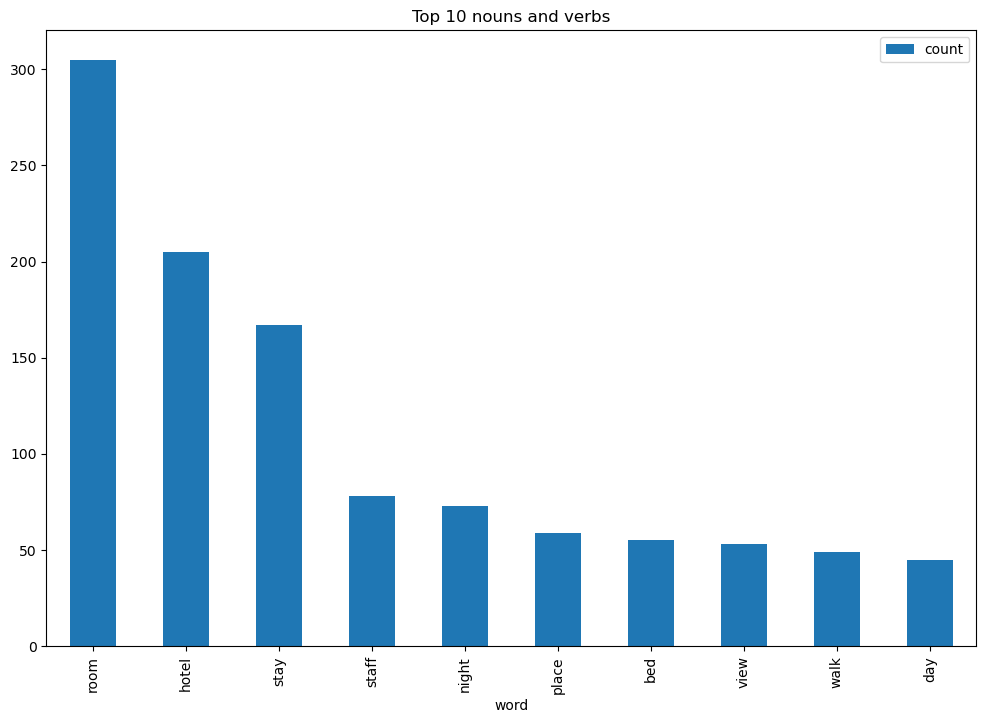

In [48]:
wd_df[0:10].plot.bar(x='word',figsize=(12,8),title='Top 10 nouns and verbs')

In [49]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import TfidfTransformer

cv2 = CountVectorizer(stop_words=stop_words_keywords,ngram_range=(2,2))
cv2_x = cv2.fit_transform(corpus)
tfidf_transformer = TfidfTransformer(smooth_idf=True, use_idf=True)
tfidf_transformer.fit(cv2_x)

# get feature names
feature_names = cv2.get_feature_names_out()

# fetch document for which keywords needs to be extracted
doc = corpus[7]

# generate tf-idf for the given document
tf_idf_vector = tfidf_transformer.transform(cv2.transform([doc]))

In [50]:
#Function for sorting tf_idf in descending order
def sort_coo(coo_matrix):
    tuples = zip(coo_matrix.col, coo_matrix.data)
    return sorted(tuples, key=lambda x: (x[1], x[0]), reverse=True)

def extract_topn_from_vector(feature_names, sorted_items, topn=10):
    """get the feature names and tf-idf score of top n items"""

    #use only topn items from vector
    sorted_items = sorted_items[:topn]

    score_vals = []
    feature_vals = []

    # word index and corresponding tf-idf score
    for idx, score in sorted_items:

        #keep track of feature name and its corresponding score
        score_vals.append(round(score, 3))
        feature_vals.append(feature_names[idx])

    #create a tuples of feature,score
    #results = zip(feature_vals,score_vals)
    results= {}
    for idx in range(len(feature_vals)):
        results[feature_vals[idx]]=score_vals[idx]

    return results

In [51]:
#sort the tf-idf vectors by descending order of scores
sorted_items = sort_coo(tf_idf_vector.tocoo())
#extract only the top n; n here is 10
keywords = extract_topn_from_vector(feature_names,sorted_items,10)

# now print the results
print("\nSentence:")
print(doc)
print("\nAttribute:")
for k in keywords:
    print(k,keywords[k])


Sentence:
excellent staff housekeeping quality hotel chocked staff make feel home experienced exceptional service desk staff concierge door men maid service needs work maid failed tuck sheets foot bed instance soiled sheets used staff quickley resolved soiled sheets issue guess relates employee reflection rest staffwe received excellent advice concierge regarding resturants area happy hour wine tasting nice touch staff went way make feel homegreat location like close good food shopping took play 5th street theather wellpikes market pioneer square access mono rail short walking distance

Attribute:
soiled sheets 0.248
make feel 0.143
work maid 0.124
wellpikes market 0.124
tuck sheets 0.124
took play 0.124
theather wellpikes 0.124
street theather 0.124
staffwe received 0.124
staff quickley 0.124


In [52]:
tfidf2 = TfidfVectorizer(norm="l2",analyzer='word', stop_words=stop_words_keywords,ngram_range=(2,2))
tfidf2_x = tfidf2.fit_transform(corpus)
tfidf_transformer = TfidfTransformer(smooth_idf=True, use_idf=True)
tfidf_transformer.fit(tfidf2_x)

# get feature names
feature_names = tfidf2.get_feature_names_out()

# fetch document for which keywords needs to be extracted
doc = corpus[14]

# generate tf-idf for the given document
tf_idf_vector = tfidf_transformer.transform(tfidf2.transform([doc]))

In [53]:
#sort the tf-idf vectors by descending order of scores
sorted_items = sort_coo(tf_idf_vector.tocoo())
#extract only the top n; n here is 10
keywords = extract_topn_from_vector(feature_names,sorted_items,10)

# now print the results
print("\nSentence:")
print(doc)
print("\nAttribute:")
for k in keywords:
    print(k,keywords[k])


Sentence:
great hotel night quick business trip loved little touches like goldfish leopard print robe complaint wifi complimentary internet access business center great location library service fabulous

Attribute:
wifi complimentary 0.28
touches goldfish 0.28
print robe 0.28
goldfish leopard 0.28
complaint wifi 0.28
robe complaint 0.258
location library 0.258
library service 0.258
leopard print 0.244
quick business 0.232


In [54]:
tfidf = TfidfVectorizer(max_features=3000,ngram_range=(3,3))
# tfidf = TfidfVectorizer()
# TFIDF for X-train
corpus_tfidf= tfidf.fit_transform(corpus)
corpus_tfidf




<20491x3000 sparse matrix of type '<class 'numpy.float64'>'
	with 60309 stored elements in Compressed Sparse Row format>

In [55]:
# To save & load models
from pickle import dump
from pickle import load
# save the model to disk
filename = 'model_TFIDF.sav'
dump(tfidf, open('model_TFIDF.sav', 'wb'))

# Emotion Mining - Sentiment Analysis

In [56]:
from nltk import tokenize
sentences=tokenize.sent_tokenize(' '.join(df.Review))
sentences

["nice hotel expensive parking got good deal stay hotel anniversary, arrived late evening took advice previous reviews did valet parking, check quick easy, little disappointed non-existent view room room clean nice size, bed comfortable woke stiff neck high pillows, not soundproof like heard music room night morning loud bangs doors opening closing hear people talking hallway, maybe just noisy neighbors, aveda bath products nice, did not goldfish stay nice touch taken advantage staying longer, location great walking distance shopping, overall nice experience having pay 40 parking night,   ok nothing special charge diamond member hilton decided chain shot 20th anniversary seattle, start booked suite paid extra website description not, suite bedroom bathroom standard hotel room, took printed reservation desk showed said things like tv couch ect desk clerk told oh mixed suites description kimpton website sorry free breakfast, got kidding, embassy suits sitting room bathroom bedroom unlike

In [57]:
len(sentences)

376

isolating reviews column with sentences


In [58]:
df2=pd.DataFrame(sentences,columns=['reviews'])
df2

,reviews
0,nice hotel expensive parking got good deal sta...
1,decided book mediterranean suite 3 night weeke...
2,10- 12 pm/am lounge cleaned hotel staff vacuum...
3,etc.expedia apparantly wo n't publish negative...
4,"23.00 night parking ridiculous, stay got good ..."
...,...
371,pool restaraunt lobby check-in nice check-in b...
372,"ensuite midle room didnt close floor slant, sp..."
373,"reasonably priced, florence jewel summer crowd..."
374,ca n't remember selections food different beve...


 using affinn Wordlist-based approach for sentiment analysis

In [59]:
!pip install afinn
from afinn import Afinn
afinn = Afinn()

Defaulting to user installation because normal site-packages is not writeable


In [60]:
nlp=spacy.load('en_core_web_sm')

def calculate_sentiment(text:str=None):
    sent_score=0
    if text:
        sentence=nlp(text)
        for word in sentence:
            sent_score+=afinn.score(word.lemma_)
    return sent_score

In [61]:
calculate_sentiment(text='bad')


-3.0

In [62]:
df2['sentiment_value']=df2['reviews'].apply(calculate_sentiment)
df2['sentiment_value']

0        66.0
1      1392.0
2       222.0
3      1340.0
4       141.0
        ...  
371     209.0
372     533.0
373      85.0
374     139.0
375    1967.0
Name: sentiment_value, Length: 376, dtype: float64

In [63]:
df2

,reviews,sentiment_value
0,nice hotel expensive parking got good deal sta...,66.0
1,decided book mediterranean suite 3 night weeke...,1392.0
2,10- 12 pm/am lounge cleaned hotel staff vacuum...,222.0
3,etc.expedia apparantly wo n't publish negative...,1340.0
4,"23.00 night parking ridiculous, stay got good ...",141.0
...,...,...
371,pool restaraunt lobby check-in nice check-in b...,209.0
372,"ensuite midle room didnt close floor slant, sp...",533.0
373,"reasonably priced, florence jewel summer crowd...",85.0
374,ca n't remember selections food different beve...,139.0


In [64]:
df2['sentiment_value'].describe()

count     376.000000
mean     1146.728723
std      1327.622509
min        -8.000000
25%       138.500000
50%       695.500000
75%      1669.500000
max      6682.000000
Name: sentiment_value, dtype: float64

negative reviews

In [65]:
df2[df2['sentiment_value']<0]
#very few vreviews with extrene

,reviews,sentiment_value
9,"king bed large room 90 plus 14 tax, free parki...",-5.0
44,gilligan island coral reef just island western...,-1.0
72,going trolley service runs 15 minutes.sports t...,-6.0
73,"drinks just o.k, nothing compare manhattan n't...",-3.0
88,"tour desk absolute disaster, book tours condad...",-3.0
89,"day returned room 1pm swimming, housekeeper en...",-2.0
90,ordered heineken pool watched minutes waitress...,-1.0
99,"3 bug spray, room tiny unkown insects, nothing...",-1.0
275,carpets loose floors wall air spaces smell roo...,-8.0


<Axes: xlabel='sentiment_value', ylabel='Density'>

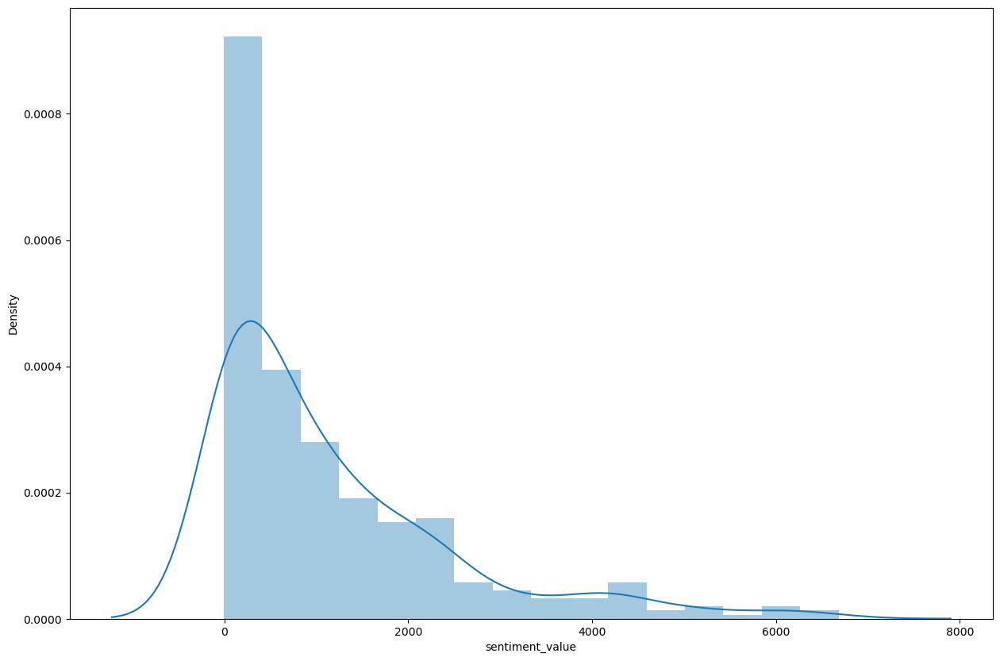

In [66]:
import seaborn as sns
plt.figure(figsize=(15,10))
sns.distplot(df2['sentiment_value'])

In [67]:
df2['index']=range(0,len(df2))
df2

,reviews,sentiment_value,index
0,nice hotel expensive parking got good deal sta...,66.0,0
1,decided book mediterranean suite 3 night weeke...,1392.0,1
2,10- 12 pm/am lounge cleaned hotel staff vacuum...,222.0,2
3,etc.expedia apparantly wo n't publish negative...,1340.0,3
4,"23.00 night parking ridiculous, stay got good ...",141.0,4
...,...,...,...
371,pool restaraunt lobby check-in nice check-in b...,209.0,371
372,"ensuite midle room didnt close floor slant, sp...",533.0,372
373,"reasonably priced, florence jewel summer crowd...",85.0,373
374,ca n't remember selections food different beve...,139.0,374


<Axes: xlabel='index', ylabel='sentiment_value'>

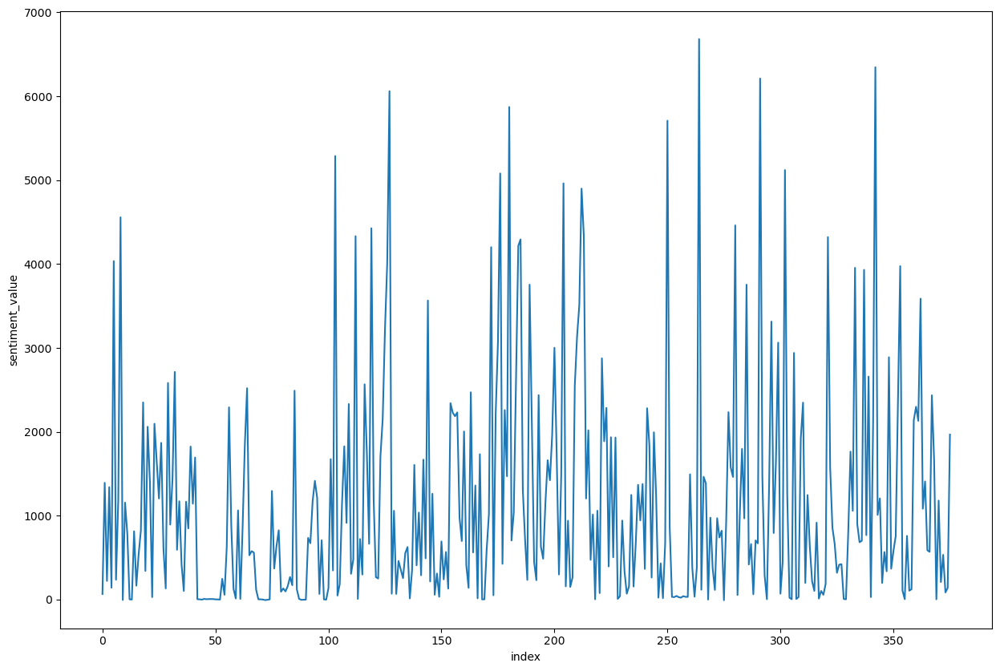

In [68]:
plt.figure(figsize=(15,10))
sns.lineplot(y='sentiment_value',x='index',data=df2)

creating new negative words list with affin sentiment value

In [69]:
neg_sentences=tokenize.sent_tokenize(' '.join(df2[df2['sentiment_value']<0].reviews))
neg_sentences

['king bed large room 90 plus 14 tax, free parking.my wife usually reserve two-bedroom suite couple 325 total great place entertain san francisco, suite expansive living/dinning area, kitchen smaller size adequate wine snacks dinner entertaining, going number years not bad experience, prefer type neighborhood hotel location pricing, enjoy,   cow hollow run down/rude desk stayed cow hollow years, past years really gone hill, service desk horrible, just right rude, ask specific backside room king etc.',
 'gilligan island coral reef just island western tip, walk dock right people turning left duck fence pick picnic-table shelter close western edge get.',
 "going trolley service runs 15 minutes.sports tennis golf available easy book.entertainment salsa night lobby disco hip-hop rap night pub awesome lounge reminded bed south beach so-so/cons buffets better not terrible thursday night dominican night los attabalos buffer worst, did n't eat heard bad things regarding international american g

In [70]:
nlp=spacy.load('en_core_web_sm')
neg_doc=nlp(' '.join(neg_sentences))
print(neg_doc)

king bed large room 90 plus 14 tax, free parking.my wife usually reserve two-bedroom suite couple 325 total great place entertain san francisco, suite expansive living/dinning area, kitchen smaller size adequate wine snacks dinner entertaining, going number years not bad experience, prefer type neighborhood hotel location pricing, enjoy,   cow hollow run down/rude desk stayed cow hollow years, past years really gone hill, service desk horrible, just right rude, ask specific backside room king etc. gilligan island coral reef just island western tip, walk dock right people turning left duck fence pick picnic-table shelter close western edge get. going trolley service runs 15 minutes.sports tennis golf available easy book.entertainment salsa night lobby disco hip-hop rap night pub awesome lounge reminded bed south beach so-so/cons buffets better not terrible thursday night dominican night los attabalos buffer worst, did n't eat heard bad things regarding international american grill resta

In [71]:
lemmas=[token.lemma_ for token in neg_doc]
print(lemmas)

['king', 'bed', 'large', 'room', '90', 'plus', '14', 'tax', ',', 'free', 'parking.my', 'wife', 'usually', 'reserve', 'two', '-', 'bedroom', 'suite', 'couple', '325', 'total', 'great', 'place', 'entertain', 'san', 'francisco', ',', 'suite', 'expansive', 'living', '/', 'din', 'area', ',', 'kitchen', 'small', 'size', 'adequate', 'wine', 'snack', 'dinner', 'entertain', ',', 'go', 'number', 'year', 'not', 'bad', 'experience', ',', 'prefer', 'type', 'neighborhood', 'hotel', 'location', 'pricing', ',', 'enjoy', ',', '  ', 'cow', 'hollow', 'run', 'down', '/', 'rude', 'desk', 'stay', 'cow', 'hollow', 'year', ',', 'past', 'year', 'really', 'go', 'hill', ',', 'service', 'desk', 'horrible', ',', 'just', 'right', 'rude', ',', 'ask', 'specific', 'backside', 'room', 'king', 'etc', '.', 'gilligan', 'island', 'coral', 'reef', 'just', 'island', 'western', 'tip', ',', 'walk', 'dock', 'right', 'people', 'turn', 'leave', 'duck', 'fence', 'pick', 'picnic', '-', 'table', 'shelter', 'close', 'western', 'edge'

In [72]:
clean_neg_lemas=' '.join(lemmas)
clean_neg_lemas

'king bed large room 90 plus 14 tax , free parking.my wife usually reserve two - bedroom suite couple 325 total great place entertain san francisco , suite expansive living / din area , kitchen small size adequate wine snack dinner entertain , go number year not bad experience , prefer type neighborhood hotel location pricing , enjoy ,    cow hollow run down / rude desk stay cow hollow year , past year really go hill , service desk horrible , just right rude , ask specific backside room king etc . gilligan island coral reef just island western tip , walk dock right people turn leave duck fence pick picnic - table shelter close western edge get . go trolley service run 15 minutes.sport tennis golf available easy book.entertainment salsa night lobby disco hip - hop rap night pub awesome lounge remind bed south beach so - so / con buffet well not terrible thursday night dominican night los attabalos buffer bad , do not eat hear bad thing regard international american grill restaurans chin

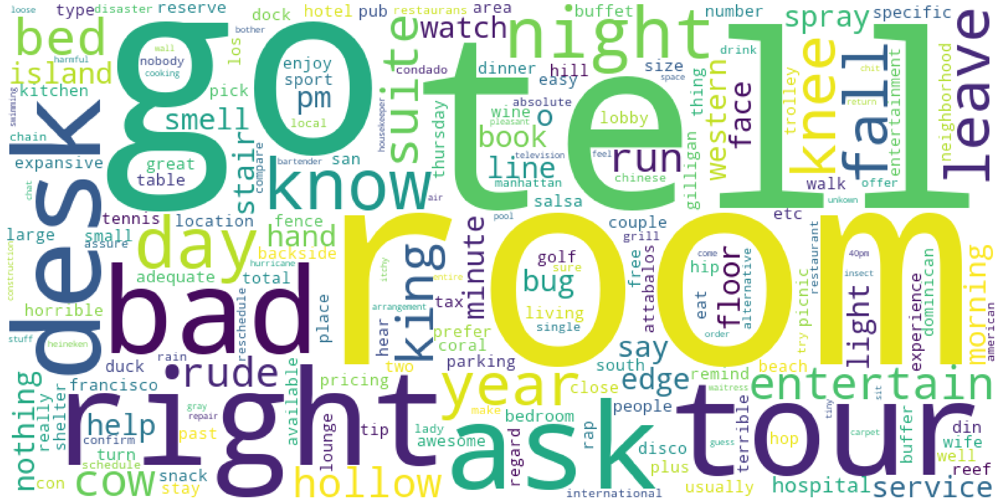

In [73]:
def plot_cloud(wordcloud):
    plt.figure(figsize=(40,30))
    plt.imshow(wordcloud)
    plt.axis('off')

# Generate Word Cloud

wordcloud = WordCloud(width=800, height=400,background_color='White').generate(clean_neg_lemas)
plot_cloud(wordcloud)

In [74]:
df.head(10)

,Review,Feedback,len,Feedback2,cleaned_review
0,nice hotel expensive parking got good deal sta...,Pos,593,1,nice hotel expensive parking got good deal sta...
1,ok nothing special charge diamond member hilto...,Neg,1689,0,ok nothing special charge diamond member hilto...
2,nice rooms not 4* experience hotel monaco seat...,Pos,1427,1,nice rooms 4 experience hotel monaco seattle g...
3,"unique, great stay, wonderful time hotel monac...",Pos,600,1,unique great stay wonderful time hotel monaco ...
4,"great stay great stay, went seahawk game aweso...",Pos,1281,1,great stay great stay went seahawk game awesom...
5,love monaco staff husband stayed hotel crazy w...,Pos,1002,1,love monaco staff husband stayed hotel crazy w...
6,"cozy stay rainy city, husband spent 7 nights m...",Pos,748,1,cozy stay rainy city husband spent 7 nights mo...
7,"excellent staff, housekeeping quality hotel ch...",Pos,597,1,excellent staff housekeeping quality hotel cho...
8,"hotel stayed hotel monaco cruise, rooms genero...",Pos,419,1,hotel stayed hotel monaco cruise rooms generou...
9,excellent stayed hotel monaco past w/e delight...,Pos,271,1,excellent stayed hotel monaco past delight rec...


## Model building

create x and y variable for models

In [76]:
# Creation of X and Y variable
x = df.cleaned_review
y = df.Feedback

In [75]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, confusion_matrix, accuracy_score
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.ensemble import RandomForestClassifier

In [77]:
X_train, X_test, y_train, y_test = train_test_split(x,y, test_size=0.3, random_state= 33)

In [78]:
countvector = CountVectorizer(ngram_range=(2,2))
X_train_v = countvector.fit_transform(X_train)
X_test_v = countvector.transform(X_test)

## Model 1. logistic regression

In [79]:
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression()
lr.fit(X_train_v, y_train)

LogisticRegression()

In [80]:
# Predict on the training data
y_train_pred = lr.predict(X_train_v)

# Predict on test data
y_test_pred = lr.predict(X_test_v)

testing_accuracy_lr = accuracy_score(y_test, y_test_pred)
training_accuracy_lr = accuracy_score(y_train, y_train_pred)
print(f'Training Accuracy of LogisticRegression: {training_accuracy_lr:.2f}')
print(f'Testing Accuracy of LogisticRegression: {testing_accuracy_lr:.2f}')

Training Accuracy of LogisticRegression: 1.00
Testing Accuracy of LogisticRegression: 0.89


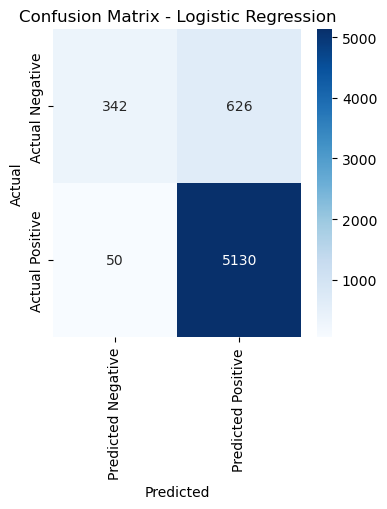

In [81]:
# Confusion Matrix for Logistic Regression
cm = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted Negative', 'Predicted Positive'],
            yticklabels=['Actual Negative', 'Actual Positive'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix - Logistic Regression')
plt.show()

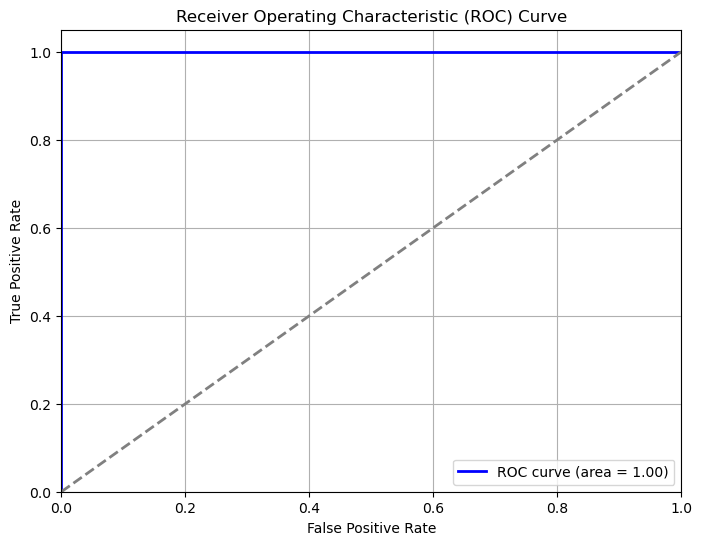

In [106]:
from sklearn.metrics import roc_curve, auc

# Assuming lr is your LogisticRegression model
# and X_train_v, y_train are your training data
y_train_numeric = [1 if label == 'Pos' else 0 for label in y_train]
# Get predicted probabilities for the positive class
y_scores = lr.predict_proba(X_train_v)[:, 1]

# Compute ROC curve and ROC area
fpr, tpr, _ = roc_curve(y_train_numeric, y_scores)
roc_auc = auc(fpr, tpr)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

In [82]:
predictions_lr = lr.predict(X_test_v)

In [83]:
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score
report_lr=classification_report(y_test,predictions_lr)
print(report_lr)

              precision    recall  f1-score   support

         Neg       0.87      0.35      0.50       968
         Pos       0.89      0.99      0.94      5180

    accuracy                           0.89      6148
   macro avg       0.88      0.67      0.72      6148
weighted avg       0.89      0.89      0.87      6148



## Model 2. Random Forest Classifier

In [84]:
rfc=RandomForestClassifier(n_estimators=100,criterion='entropy')
rfc.fit(X_train_v,y_train)

RandomForestClassifier(criterion='entropy')

In [85]:
# Predict on the training data
y_rfc_train_pred = rfc.predict(X_train_v)

# Predict on test data
y_rfc_test_pred = rfc.predict(X_test_v)

testing_accuracy_rfc = accuracy_score(y_test, y_rfc_test_pred)
training_accuracy_rfc = accuracy_score(y_train, y_rfc_train_pred)
print(f'Training Accuracy of RandomForest: {training_accuracy_rfc:.2f}')
print(f'Testing Accuracy of RandomForest: {testing_accuracy_rfc:.2f}')

Training Accuracy of RandomForest: 1.00
Testing Accuracy of RandomForest: 0.86


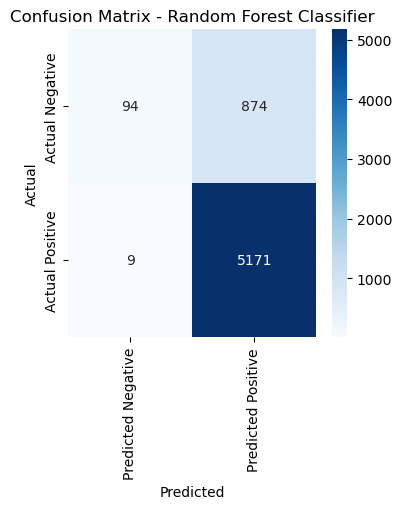

In [86]:
# Confusion Matrix for Random Forest Classifier
cm = confusion_matrix(y_test, y_rfc_test_pred)
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted Negative', 'Predicted Positive'],
            yticklabels=['Actual Negative', 'Actual Positive'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix - Random Forest Classifier')
plt.show()

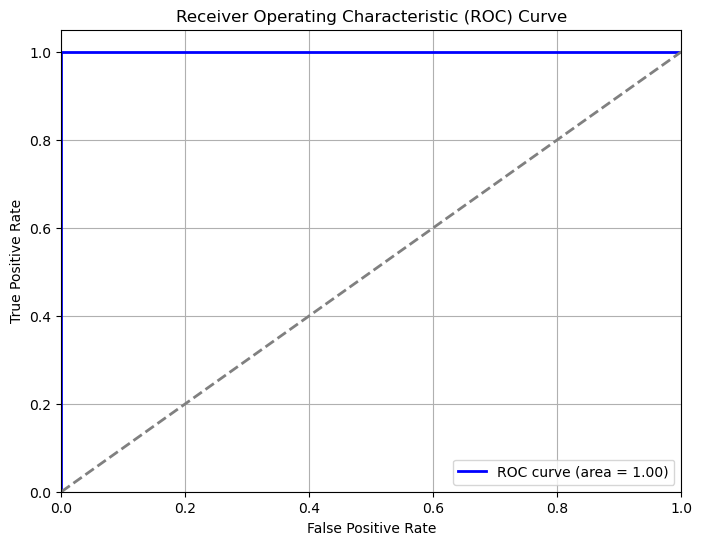

In [107]:
y_scores2 = rfc.predict_proba(X_train_v)[:, 1]

# Compute ROC curve and ROC area
fpr, tpr, _ = roc_curve(y_train_numeric, y_scores2)
roc_auc = auc(fpr, tpr)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

In [87]:
predictions_rfc = rfc.predict(X_test_v)

In [88]:
report_rfc=classification_report(y_test,predictions_rfc)
print(report_rfc)

              precision    recall  f1-score   support

         Neg       0.91      0.10      0.18       968
         Pos       0.86      1.00      0.92      5180

    accuracy                           0.86      6148
   macro avg       0.88      0.55      0.55      6148
weighted avg       0.86      0.86      0.80      6148



## Model 3 Naive Bayes

In [89]:
from sklearn.naive_bayes import MultinomialNB
nbc = MultinomialNB()
nbc.fit(X_train_v, y_train)

MultinomialNB()

In [90]:
# Predict on the training data
y_nb_train_pred = nbc.predict(X_train_v)

# Predict on test data
y_nb_test_pred = nbc.predict(X_test_v)

testing_accuracy_nb = accuracy_score(y_test, y_nb_test_pred)
training_accuracy_nb = accuracy_score(y_train, y_nb_train_pred)
print(f'Training Accuracy of Naive Bayes: {training_accuracy_nb:.2f}')
print(f'Testing Accuracy of Naive Bayes: {testing_accuracy_nb:.2f}')

Training Accuracy of Naive Bayes: 1.00
Testing Accuracy of Naive Bayes: 0.87


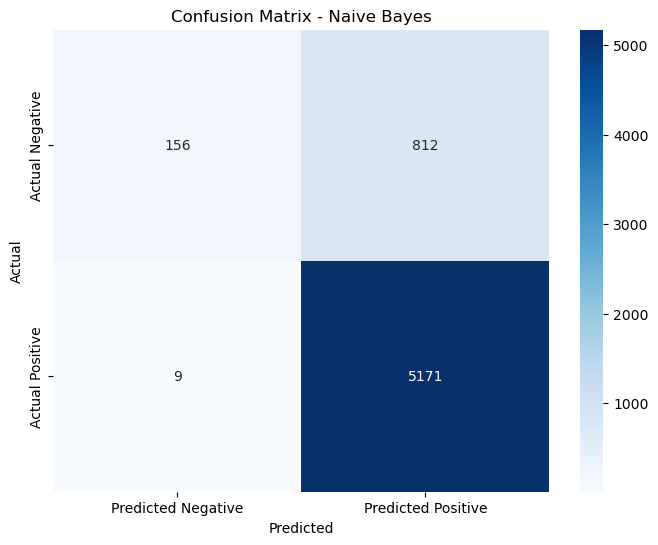

In [91]:
# Confusion Matrix for Naive Bayes
cm = confusion_matrix(y_test, y_nb_test_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted Negative', 'Predicted Positive'],
            yticklabels=['Actual Negative', 'Actual Positive'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix - Naive Bayes')
plt.show()

In [92]:
predictions_nbc = nbc.predict(X_test_v)

In [93]:
report_nbc=classification_report(y_test,predictions_nbc)
print(report_nbc)

              precision    recall  f1-score   support

         Neg       0.95      0.16      0.28       968
         Pos       0.86      1.00      0.93      5180

    accuracy                           0.87      6148
   macro avg       0.90      0.58      0.60      6148
weighted avg       0.88      0.87      0.82      6148



## Model 4 Support Vector Machine

In [94]:
from sklearn.svm import SVC
svm= SVC()
svm.fit(X_train_v, y_train)

SVC()

In [95]:
# Predict on the training data
y_svm_train_pred = svm.predict(X_train_v)

# Predict on test data
y_svm_test_pred = svm.predict(X_test_v)

testing_accuracy_svm = accuracy_score(y_test, y_svm_test_pred)
training_accuracy_svm = accuracy_score(y_train, y_svm_train_pred)
print(f'Training Accuracy of Support Vector: {training_accuracy_svm:.2f}')
print(f'Testing Accuracy of Support Vector: {testing_accuracy_svm:.2f}')

Training Accuracy of Support Vector: 0.97
Testing Accuracy of Support Vector: 0.85


In [96]:
# Predict on the training data
y_svm_train_pred = svm.predict(X_train_v)

# Predict on test data
y_svm_test_pred = svm.predict(X_test_v)

testing_accuracy_svm = accuracy_score(y_test, y_svm_test_pred)
training_accuracy_svm = accuracy_score(y_train, y_svm_train_pred)
print(f'Training Accuracy of Support Vector: {training_accuracy_svm:.2f}')
print(f'Testing Accuracy of Support Vector: {testing_accuracy_svm:.2f}')

Training Accuracy of Support Vector: 0.97
Testing Accuracy of Support Vector: 0.85


In [97]:
predictions_svm = svm.predict(X_test_v)

In [98]:
report_sv=classification_report(y_test,predictions_svm)
print(report_sv)

              precision    recall  f1-score   support

         Neg       0.94      0.05      0.09       968
         Pos       0.85      1.00      0.92      5180

    accuracy                           0.85      6148
   macro avg       0.89      0.52      0.51      6148
weighted avg       0.86      0.85      0.79      6148



## Model 5 K-Nearest Neigbors

In [99]:
from sklearn.neighbors import KNeighborsClassifier
knn=KNeighborsClassifier()
knn.fit(X_train_v, y_train)

KNeighborsClassifier()

In [100]:
# Predict on the training data
y_knn_train_pred = knn.predict(X_train_v)

# Predict on test data
y_knn_test_pred = knn.predict(X_test_v)

testing_accuracy_knn = accuracy_score(y_test, y_knn_test_pred)
training_accuracy_knn = accuracy_score(y_train, y_knn_train_pred)
print(f'Training Accuracy of Naive Bayes: {training_accuracy_knn:.2f}')
print(f'Testing Accuracy of Naive Bayes: {testing_accuracy_knn:.2f}')

Training Accuracy of Naive Bayes: 0.84
Testing Accuracy of Naive Bayes: 0.84


In [101]:
# Predict on the training data
y_knn_train_pred = knn.predict(X_train_v)

# Predict on test data
y_knn_test_pred = knn.predict(X_test_v)

testing_accuracy_knn = accuracy_score(y_test, y_knn_test_pred)
training_accuracy_knn = accuracy_score(y_train, y_knn_train_pred)
print(f'Training Accuracy of Naive Bayes: {training_accuracy_knn:.2f}')
print(f'Testing Accuracy of Naive Bayes: {testing_accuracy_knn:.2f}')

Training Accuracy of Naive Bayes: 0.84
Testing Accuracy of Naive Bayes: 0.84


In [102]:
predictions_knn = knn.predict(X_test_v)

In [103]:
report_knn=classification_report(y_test,predictions_knn)
print(report_knn)

              precision    recall  f1-score   support

         Neg       0.00      0.00      0.00       968
         Pos       0.84      1.00      0.91      5180

    accuracy                           0.84      6148
   macro avg       0.42      0.50      0.46      6148
weighted avg       0.71      0.84      0.77      6148



In [104]:
tfidf


TfidfVectorizer(max_features=3000, ngram_range=(3, 3))